## Problem Statement

This tutorial takes a practical and coding-focused approach. We'll learn how to use _decision trees_ and _random forests_ to solve a real-world problem from [Kaggle](https://kaggle.com/datasets):

> **QUESTION**: The [Rain in Australia dataset](https://kaggle.com/jsphyg/weather-dataset-rattle-package) contains about 10 years of daily weather observations from numerous Australian weather stations. Here's a small sample from the dataset:
> 
> ![](https://i.imgur.com/5QNJvir.png)
>
> As a data scientist at the Bureau of Meteorology, you are tasked with creating a fully-automated system that can use today's weather data for a given location to predict whether it will rain at the location tomorrow. 
>
>
> ![](https://i.imgur.com/KWfcpcO.png)


In [1]:
!pip install pandas-profiling numpy matplotlib seaborn --quiet

In [2]:
!pip install opendatasets scikit-learn --quiet

In [3]:
# import libraries and adjust data visualization settings
import opendatasets as od
import matplotlib.pyplot as plt 
import seaborn as sns 
import pandas as pd 
import numpy as np 
import matplotlib
import os 
%matplotlib inline 

pd.set_option ('display.max_columns', None)
pd.set_option ('display.max_rows', 150)
sns.set_style('darkgrid')
matplotlib.rcParams['font.size'] = 14 
matplotlib.rcParams['figure.figsize'] = (10,6)
matplotlib.rcParams['figure.facecolor'] = '#00000000'

In [4]:
#download data
od.download('https://www.kaggle.com/datasets/jsphyg/weather-dataset-rattle-package')

Skipping, found downloaded files in ".\weather-dataset-rattle-package" (use force=True to force download)


In [5]:
os.listdir('weather-dataset-rattle-package')

['weatherAUS.csv']

In [6]:
weather_df = pd.read_csv('weather-dataset-rattle-package/weatherAUS.csv')

In [7]:
from ydata_profiling import ProfileReport

In [8]:
weather_report = ProfileReport(weather_df)

In [9]:
weather_report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [10]:
weather_df.dropna(subset = ['RainTomorrow'], inplace = True)

# Preparing Data for Training

## Training, Validation and Test Sets 

<Axes: title={'center': 'No. of Rows per Year'}, xlabel='Date', ylabel='count'>

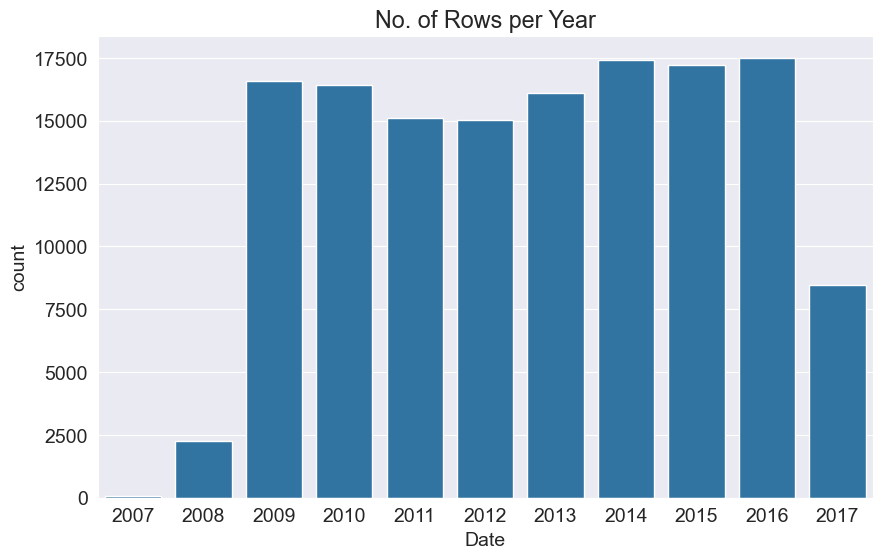

In [11]:
plt.title("No. of Rows per Year")
sns.countplot(x = pd.to_datetime(weather_df['Date']).dt.year)

In [12]:
#separate data according to years 
year = pd.to_datetime(weather_df.Date).dt.year

In [13]:
train_df = weather_df[year < 2015] 
val_df = weather_df[year == 2015] 
test_df = weather_df [year > 2015]

In [14]:
#Identifying Input and Target Columns 
input_cols = list(train_df.columns)[1:-1]
target_col = "RainTomorrow"

In [15]:
train_inputs = train_df[input_cols].copy()
train_target = train_df[target_col].copy()

val_inputs = val_df[input_cols].copy()
val_target = val_df[target_col].copy()

test_inputs = test_df[input_cols].copy()
test_target = test_df[target_col].copy()

In [16]:
#identify numerical and cateogrical columns 
numeric_cols = train_inputs.select_dtypes(include = np.number).columns.tolist()
categorical_cols = train_inputs.select_dtypes ('object').columns.tolist()

In [17]:
print("Numer:", numeric_cols)
print("Categ:", categorical_cols)

Numer: ['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm']
Categ: ['Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday']


## Imputing Missing Numeric Values 

In [18]:
from sklearn.impute import SimpleImputer

Can try DIFFERENT IMPUTATION STRATEGIES

In [19]:
imputer = SimpleImputer(strategy = 'mean').fit(weather_df[numeric_cols])

In [20]:
train_inputs[numeric_cols] = imputer.transform(train_inputs[numeric_cols])
val_inputs[numeric_cols] = imputer.transform(val_inputs[numeric_cols])
test_inputs[numeric_cols] = imputer.transform(test_inputs[numeric_cols])

In [21]:
test_inputs[numeric_cols].isna().sum()

MinTemp          0
MaxTemp          0
Rainfall         0
Evaporation      0
Sunshine         0
WindGustSpeed    0
WindSpeed9am     0
WindSpeed3pm     0
Humidity9am      0
Humidity3pm      0
Pressure9am      0
Pressure3pm      0
Cloud9am         0
Cloud3pm         0
Temp9am          0
Temp3pm          0
dtype: int64

In [22]:
from sklearn.preprocessing import OneHotEncoder

In [23]:
encoder = OneHotEncoder(sparse_output = False, handle_unknown = 'ignore').fit(weather_df[categorical_cols])
#sparse_output = True will return a sparse matrix, Else will return an array 
#handle_unknown = 'ignore': for unknown category, resulting one-hot  encoded columns for this feature will be all zeroes
#handle_unkonwn = 'error' will raise an arror if an unknown category is present 

In [24]:
encoded_cols = list(encoder.get_feature_names_out(categorical_cols))

In [25]:
#to add one-hot encoded columns 
train_inputs[encoded_cols] = encoder.transform(train_inputs[categorical_cols])
val_inputs[encoded_cols] = encoder.transform(val_inputs[categorical_cols])
test_inputs[encoded_cols] = encoder.transform(test_inputs[categorical_cols])

C:\Users\jingh\AppData\Local\Temp\ipykernel_30584\2995392315.py:2: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  train_inputs[encoded_cols] = encoder.transform(train_inputs[categorical_cols])
C:\Users\jingh\AppData\Local\Temp\ipykernel_30584\2995392315.py:2: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  train_inputs[encoded_cols] = encoder.transform(train_inputs[categorical_cols])
C:\Users\jingh\AppData\Local\Temp\ipykernel_30584\2995392315.py:2: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of 

In [26]:
train_inputs

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,Location_Adelaide,Location_Albany,Location_Albury,Location_AliceSprings,Location_BadgerysCreek,Location_Ballarat,Location_Bendigo,Location_Brisbane,Location_Cairns,Location_Canberra,Location_Cobar,Location_CoffsHarbour,Location_Dartmoor,Location_Darwin,Location_GoldCoast,Location_Hobart,Location_Katherine,Location_Launceston,Location_Melbourne,Location_MelbourneAirport,Location_Mildura,Location_Moree,Location_MountGambier,Location_MountGinini,Location_Newcastle,Location_Nhil,Location_NorahHead,Location_NorfolkIsland,Location_Nuriootpa,Location_PearceRAAF,Location_Penrith,Location_Perth,Location_PerthAirport,Location_Portland,Location_Richmond,Location_Sale,Location_SalmonGums,Location_Sydney,Location_SydneyAirport,Location_Townsville,Location_Tuggeranong,Location_Uluru,Location_WaggaWagga,Location_Walpole,Location_Watsonia,Location_Williamtown,Location_Witchcliffe,Location_Wollongong,Location_Woomera,WindGustDir_E,WindGustDir_ENE,WindGustDir_ESE,WindGustDir_N,WindGustDir_NE,WindGustDir_NNE,WindGustDir_NNW,WindGustDir_NW,WindGustDir_S,WindGustDir_SE,WindGustDir_SSE,WindGustDir_SSW,WindGustDir_SW,WindGustDir_W,WindGustDir_WNW,WindGustDir_WSW,WindGustDir_nan,WindDir9am_E,WindDir9am_ENE,WindDir9am_ESE,WindDir9am_N,WindDir9am_NE,WindDir9am_NNE,WindDir9am_NNW,WindDir9am_NW,WindDir9am_S,WindDir9am_SE,WindDir9am_SSE,WindDir9am_SSW,WindDir9am_SW,WindDir9am_W,WindDir9am_WNW,WindDir9am_WSW,WindDir9am_nan,WindDir3pm_E,WindDir3pm_ENE,WindDir3pm_ESE,WindDir3pm_N,WindDir3pm_NE,WindDir3pm_NNE,WindDir3pm_NNW,WindDir3pm_NW,WindDir3pm_S,WindDir3pm_SE,WindDir3pm_SSE,WindDir3pm_SSW,WindDir3pm_SW,WindDir3pm_W,WindDir3pm_WNW,WindDir3pm_WSW,WindDir3pm_nan,RainToday_No,RainToday_Yes,RainToday_nan
0,Albury,13.4,22.9,0.6,5.469824,7.624853,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,8.000000,4.503167,16.9,21.8,No,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
1,Albury,7.4,25.1,0.0,5.469824,7.624853,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,4.437189,4.503167,17.2,24.3,No,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
2,Albury,12.9,25.7,0.0,5.469824,7.624853,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,4.437189,2.000000,21.0,23.2,No,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
3,Albury,9.2,28.0,0.0,5.469824,7.624853,NE,24.0,SE,E,11.0,9.0,45.0,16.0,1017.6,1012.8,4.437189,4.503167,18.1,26.5,No,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0

In [27]:
X_train = train_inputs[numeric_cols + encoded_cols]
X_val = val_inputs[numeric_cols + encoded_cols]
X_test = test_inputs[numeric_cols + encoded_cols]

In [28]:
from sklearn.tree import DecisionTreeClassifier

In [29]:
model = DecisionTreeClassifier(random_state = 42)
#to fix the randomness inside decision tree

In [30]:
%%time
model.fit(X_train, train_target)

CPU times: total: 3.33 s
Wall time: 3.73 s


DecisionTreeClassifier(random_state=42)

In [31]:
from sklearn.metrics import accuracy_score, confusion_matrix

In [32]:
train_preds = model.predict(X_train)

In [33]:
#to count the value of Yes and No inside 
pd.Series(train_preds).value_counts()

No     76707
Yes    22281
Name: count, dtype: int64

In [34]:
train_probs = model.predict_proba(X_train)

In [35]:
train_probs

array([[1., 0.],
       [1., 0.],
       [1., 0.],
       ...,
       [1., 0.],
       [1., 0.],
       [1., 0.]])

In [36]:
accuracy_score(train_target, train_preds)

0.9999797955307714

In [37]:
#to combine predicting and computing accuracy in one step 
model.score(X_val, val_target)

0.792292960362138

In [38]:
val_target.value_counts() / len(val_target)

RainTomorrow
No     0.788289
Yes    0.211711
Name: count, dtype: float64

The accuracy on the validation set is just about 79%, slightly higher than "dumb" AllNo model

# Visualization

To visualize the decision tree learned from the training data. 

In [39]:
from sklearn.tree import plot_tree, export_text

[Text(0.5, 0.875, 'Humidity3pm <= 71.5\ngini = 0.349\nsamples = 98988\nvalue = [76705, 22283]'),
 Text(0.25, 0.625, 'Rainfall <= 1.5\ngini = 0.248\nsamples = 82418\nvalue = [70439, 11979]'),
 Text(0.125, 0.375, 'Sunshine <= 7.612\ngini = 0.198\nsamples = 69252\nvalue = [61538, 7714]'),
 Text(0.0625, 0.125, '\n  (...)  \n'),
 Text(0.1875, 0.125, '\n  (...)  \n'),
 Text(0.375, 0.375, 'Humidity3pm <= 51.241\ngini = 0.438\nsamples = 13166\nvalue = [8901, 4265]'),
 Text(0.3125, 0.125, '\n  (...)  \n'),
 Text(0.4375, 0.125, '\n  (...)  \n'),
 Text(0.75, 0.625, 'Humidity3pm <= 82.5\ngini = 0.47\nsamples = 16570\nvalue = [6266, 10304]'),
 Text(0.625, 0.375, 'WindGustSpeed <= 42.0\ngini = 0.499\nsamples = 9136\nvalue = [4804, 4332]'),
 Text(0.5625, 0.125, '\n  (...)  \n'),
 Text(0.6875, 0.125, '\n  (...)  \n'),
 Text(0.875, 0.375, 'Rainfall <= 3.7\ngini = 0.316\nsamples = 7434\nvalue = [1462, 5972]'),
 Text(0.8125, 0.125, '\n  (...)  \n'),
 Text(0.9375, 0.125, '\n  (...)  \n')]

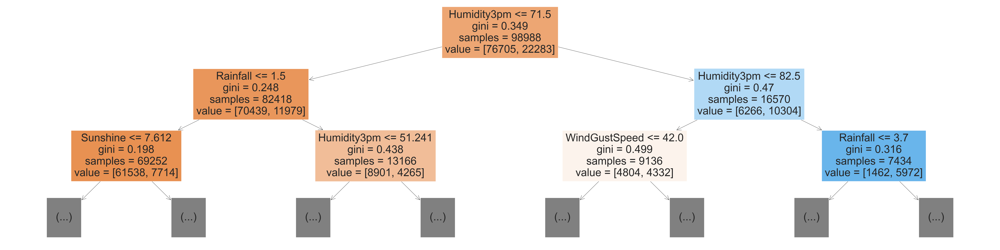

In [40]:
plt.figure(figsize = (80, 20))
plot_tree (model, feature_names = X_train.columns, max_depth = 2, filled = True)

In [41]:
model.tree_.max_depth

48

Display the tree in the form of text, which can be easier to follow for deeper trees. 

In [42]:
tree_text = export_text(model, max_depth = 10, feature_names = list(X_train.columns))
print(tree_text)

|--- Humidity3pm <= 71.50
|   |--- Rainfall <= 1.50
|   |   |--- Sunshine <= 7.61
|   |   |   |--- Pressure3pm <= 1013.55
|   |   |   |   |--- WindGustSpeed <= 53.00
|   |   |   |   |   |--- Humidity3pm <= 27.50
|   |   |   |   |   |   |--- WindDir9am_NE <= 0.50
|   |   |   |   |   |   |   |--- Location_Watsonia <= 0.50
|   |   |   |   |   |   |   |   |--- Cloud9am <= 7.50
|   |   |   |   |   |   |   |   |   |--- WindSpeed3pm <= 6.50
|   |   |   |   |   |   |   |   |   |   |--- Pressure3pm <= 1005.75
|   |   |   |   |   |   |   |   |   |   |   |--- class: Yes
|   |   |   |   |   |   |   |   |   |   |--- Pressure3pm >  1005.75
|   |   |   |   |   |   |   |   |   |   |   |--- class: No
|   |   |   |   |   |   |   |   |   |--- WindSpeed3pm >  6.50
|   |   |   |   |   |   |   |   |   |   |--- MinTemp <= 5.20
|   |   |   |   |   |   |   |   |   |   |   |--- truncated branch of depth 2
|   |   |   |   |   |   |   |   |   |   |--- MinTemp >  5.20
|   |   |   |   |   |   |   |   |   |   |   |-

## Feature Importance 

Based on the gini index computations, a decision tree assigns an "importance" value to each feature. These values can be used to interpret the results given by a decision tree.

In [43]:
model.feature_importances_

array([3.48942086e-02, 3.23605486e-02, 5.91385668e-02, 2.49619907e-02,
       4.94652143e-02, 5.63334673e-02, 2.80205998e-02, 2.98128801e-02,
       4.02182908e-02, 2.61441297e-01, 3.44145027e-02, 6.20573699e-02,
       1.36406176e-02, 1.69229866e-02, 3.50001550e-02, 3.04064076e-02,
       2.24086587e-03, 2.08018104e-03, 1.27475954e-03, 7.26936324e-04,
       1.39779517e-03, 1.15264873e-03, 6.92808159e-04, 1.80675598e-03,
       1.08370901e-03, 1.19773895e-03, 8.87119103e-04, 2.15764220e-03,
       1.67094731e-03, 7.98919493e-05, 1.10558668e-03, 1.42008656e-03,
       4.10087635e-04, 1.09028115e-03, 1.44164766e-03, 9.08284767e-04,
       1.05770304e-03, 6.18133455e-04, 1.80387272e-03, 2.10403527e-03,
       2.74413333e-04, 7.31599405e-04, 1.35408990e-03, 1.54759332e-03,
       1.30917564e-03, 1.07134670e-03, 8.36408023e-04, 1.62662229e-03,
       1.00326116e-03, 2.16053455e-03, 8.46802258e-04, 1.88919081e-03,
       9.29325203e-04, 1.29545157e-03, 1.27604831e-03, 5.12736888e-04,
      

In [44]:
type(X_train.columns)

pandas.core.indexes.base.Index

In [45]:
#turn into a dictionary --> dataframe 
importance_df = pd.DataFrame({'feature':X_train.columns, 
                               'importance': model.feature_importances_}).sort_values('importance', ascending = False)

In [46]:
importance_df.head(10)

,feature,importance
9,Humidity3pm,0.261441
11,Pressure3pm,0.062057
2,Rainfall,0.059139
5,WindGustSpeed,0.056333
4,Sunshine,0.049465
8,Humidity9am,0.040218
14,Temp9am,0.035000
0,MinTemp,0.034894
10,Pressure9am,0.034415
1,MaxTemp,0.032361


<Axes: title={'center': 'Feature Importance'}, xlabel='importance', ylabel='feature'>

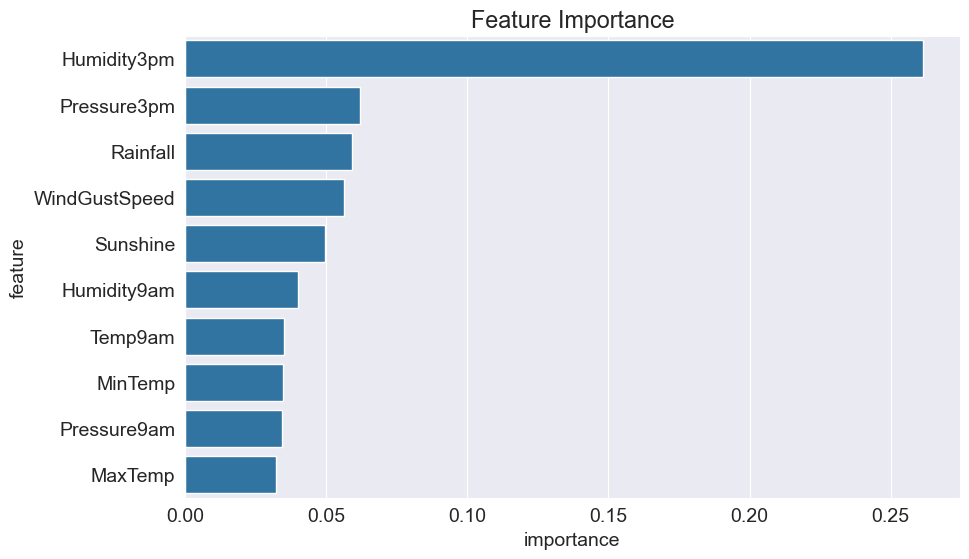

In [47]:
#plot the importance_df
plt.title('Feature Importance')
sns.barplot(data = importance_df.head(10), x = 'importance', y = 'feature')

When we observe importance of different factors. Let's say Humidity3pm tops the rank, then we can check if there's a lot of missing values in that feature, that we have filled in. Maybe we should remove humidity column, or remain filling the missing values. 

# Hyperparameter Tuning and Reducing Overfitting 
The process of reducing overfitting is called regularization. We look into some strategies to reduce overfitting. We'll use the `DecisionTreeClassifier` and tweak the some parameters. 

In [48]:
?DecisionTreeClassifier

Init signature:
DecisionTreeClassifier(
    *,
    criterion='gini',
    splitter='best',
    max_depth=None,
    min_samples_split=2,
    min_samples_leaf=1,
    min_weight_fraction_leaf=0.0,
    max_features=None,
    random_state=None,
    max_leaf_nodes=None,
    min_impurity_decrease=0.0,
    class_weight=None,
    ccp_alpha=0.0,
)
Docstring:     
A decision tree classifier.

Read more in the :ref:`User Guide <tree>`.

Parameters
----------
criterion : {"gini", "entropy", "log_loss"}, default="gini"
    The function to measure the quality of a split. Supported criteria are
    "gini" for the Gini impurity and "log_loss" and "entropy" both for the
    Shannon information gain, see :ref:`tree_mathematical_formulation`.

splitter : {"best", "random"}, default="best"
    The strategy used to choose the split at each node. Supported
    strategies are "best" to choose the best split and "random" to choose
    the best random split.

max_depth : int, default=None
    The maximum depth o

These arguments are called hyperparameters because they must be configured manually (as opposed to the parameters within the model which are _learned_ from the data. We'll explore a couple of hyperparameters:

- `max_depth`
- `max_leaf_nodes`

### `max_depth`

To avoid the model from memorizing all the training examples, we have to reduce the maximum depth of the decision tree. This leads to better generation. 

In [49]:
model = DecisionTreeClassifier(max_depth=3, random_state=42)

In [50]:
model.fit(X_train, train_target)

DecisionTreeClassifier(max_depth=3, random_state=42)

In [51]:
model.score(X_train, train_target)

0.8291308037337859

In [52]:
model.score(X_val, val_target)

0.8334397307178921

We can observe a decrease in the accuracy on training set, but an increase in the accuracy on validation set. 

In [53]:
model.classes_

array(['No', 'Yes'], dtype=object)

[Text(0.5, 0.875, 'Humidity3pm <= 71.5\ngini = 0.349\nsamples = 98988\nvalue = [76705, 22283]\nclass = No'),
 Text(0.25, 0.625, 'Rainfall <= 1.5\ngini = 0.248\nsamples = 82418\nvalue = [70439, 11979]\nclass = No'),
 Text(0.125, 0.375, 'Sunshine <= 7.612\ngini = 0.198\nsamples = 69252\nvalue = [61538, 7714]\nclass = No'),
 Text(0.0625, 0.125, 'gini = 0.363\nsamples = 12620\nvalue = [9618, 3002]\nclass = No'),
 Text(0.1875, 0.125, 'gini = 0.153\nsamples = 56632\nvalue = [51920, 4712]\nclass = No'),
 Text(0.375, 0.375, 'Humidity3pm <= 51.241\ngini = 0.438\nsamples = 13166\nvalue = [8901, 4265]\nclass = No'),
 Text(0.3125, 0.125, 'gini = 0.293\nsamples = 4299\nvalue = [3531, 768]\nclass = No'),
 Text(0.4375, 0.125, 'gini = 0.478\nsamples = 8867\nvalue = [5370, 3497]\nclass = No'),
 Text(0.75, 0.625, 'Humidity3pm <= 82.5\ngini = 0.47\nsamples = 16570\nvalue = [6266, 10304]\nclass = Yes'),
 Text(0.625, 0.375, 'WindGustSpeed <= 42.0\ngini = 0.499\nsamples = 9136\nvalue = [4804, 4332]\nclass =

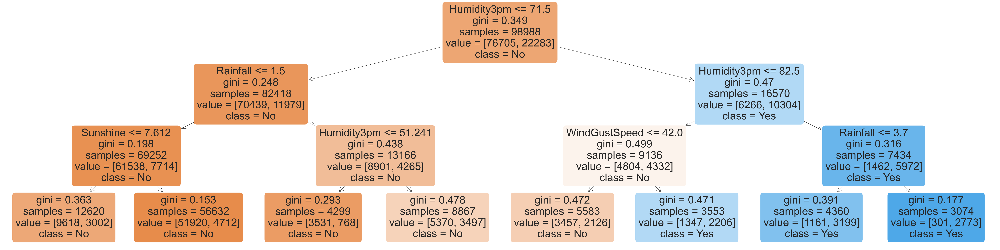

In [54]:
plt.figure(figsize = (80, 20))
plot_tree(model, feature_names = X_train.columns, filled = True, rounded = True, class_names = model.classes_)

In [55]:
print(export_text(model, feature_names=list(X_train.columns)))

|--- Humidity3pm <= 71.50
|   |--- Rainfall <= 1.50
|   |   |--- Sunshine <= 7.61
|   |   |   |--- class: No
|   |   |--- Sunshine >  7.61
|   |   |   |--- class: No
|   |--- Rainfall >  1.50
|   |   |--- Humidity3pm <= 51.24
|   |   |   |--- class: No
|   |   |--- Humidity3pm >  51.24
|   |   |   |--- class: No
|--- Humidity3pm >  71.50
|   |--- Humidity3pm <= 82.50
|   |   |--- WindGustSpeed <= 42.00
|   |   |   |--- class: No
|   |   |--- WindGustSpeed >  42.00
|   |   |   |--- class: Yes
|   |--- Humidity3pm >  82.50
|   |   |--- Rainfall <= 3.70
|   |   |   |--- class: Yes
|   |   |--- Rainfall >  3.70
|   |   |   |--- class: Yes



In [56]:
def max_depth_error(md): 
    model = DecisionTreeClassifier(max_depth = md, random_state = 42)
    model.fit(X_train, train_target)
    train_err = 1 - model.score(X_train, train_target)
    val_err = 1 - model.score(X_val, val_target)
    return {'Max Depth': md, 'Training Error': train_err, 'Validation Error': val_err}

In [57]:
%%time
errors_df = pd.DataFrame([max_depth_error(md) for md in range(1, 21)])

CPU times: total: 37 s
Wall time: 50.6 s


In [58]:
errors_df

,Max Depth,Training Error,Validation Error
0,1,0.184315,0.177935
1,2,0.179547,0.172712
2,3,0.170869,0.166560
3,4,0.165707,0.164355
4,5,0.160676,0.159074
5,6,0.156271,0.157275
6,7,0.153312,0.154605
7,8,0.147806,0.158029
8,9,0.140906,0.156578
9,10,0.132945,0.157449


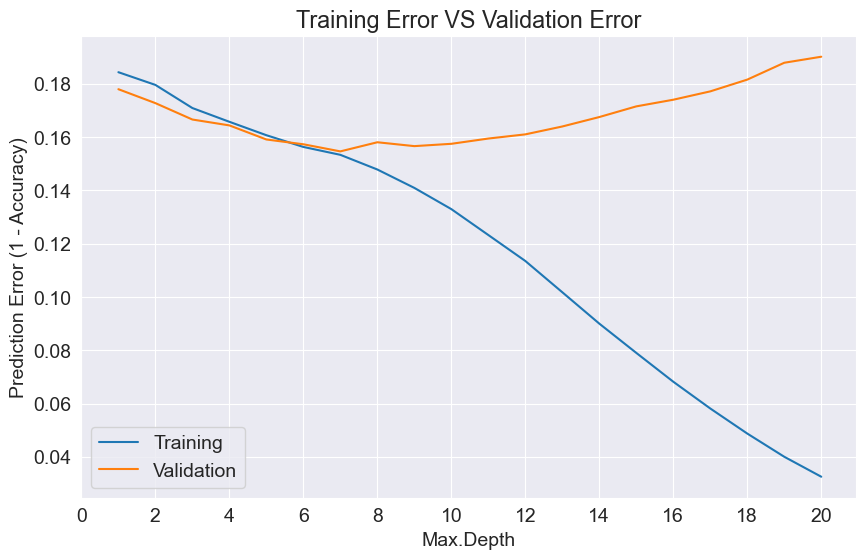

In [59]:
plt.figure()
plt.plot(errors_df['Max Depth'], errors_df['Training Error'])
plt.plot(errors_df['Max Depth'], errors_df['Validation Error'])
plt.title('Training Error VS Validation Error')
plt.xticks(range(0,21,2))
plt.xlabel('Max.Depth')
plt.ylabel('Prediction Error (1 - Accuracy)')
plt.legend(['Training', 'Validation'])

This is a common pattern we'll see with all machine learning algorithms. We'll often need to tune hyperparameters carefully to find the optimal fit. In the case above, it appears that a maximum depth of 7 results in the lowest validation error. 

<img src="https://i.imgur.com/EJCrSZw.png" width="480">





In [60]:
model = DecisionTreeClassifier(max_depth=7, random_state=42).fit(X_train, train_target)
model.score(X_val, val_target)

0.8453949277465034

### `max_leaf_nodes`
Another way to control the size of complexity of a decision tree is to limit the number of leaf nodes. This allows branches of the trees to have varying depths. 

In [61]:
model = DecisionTreeClassifier(max_leaf_nodes=128, random_state=42)

In [62]:
model.fit(X_train, train_target)

DecisionTreeClassifier(max_leaf_nodes=128, random_state=42)

In [63]:
model.score(X_train, train_target)

0.8480421869317493

In [64]:
model.score(X_val, val_target)

0.8442342290058615

In [65]:
model.tree_.max_depth

12

In [66]:
print(model.tree_.node_count)

255


In [67]:
?model.tree_

Type:        Tree
String form: <sklearn.tree._tree.Tree object at 0x0000017B6219FD70>
File:        c:\users\jingh\anaconda3\lib\site-packages\sklearn\tree\_tree.cp311-win_amd64.pyd
Docstring:  
Array-based representation of a binary decision tree.

The binary tree is represented as a number of parallel arrays. The i-th
element of each array holds information about the node `i`. Node 0 is the
tree's root. You can find a detailed description of all arrays in
`_tree.pxd`. NOTE: Some of the arrays only apply to either leaves or split
nodes, resp. In this case the values of nodes of the other type are
arbitrary!

Attributes
----------
node_count : int
    The number of nodes (internal nodes + leaves) in the tree.

capacity : int
    The current capacity (i.e., size) of the arrays, which is at least as
    great as `node_count`.

max_depth : int
    The depth of the tree, i.e. the maximum depth of its leaves.

children_left : array of int, shape [node_count]
    children_left[i] holds the no

In [68]:
model_text = export_text(model, feature_names=list(X_train.columns))
print(model_text[:3000])

|--- Humidity3pm <= 71.50
|   |--- Rainfall <= 1.50
|   |   |--- Sunshine <= 7.61
|   |   |   |--- Pressure3pm <= 1013.55
|   |   |   |   |--- WindGustSpeed <= 53.00
|   |   |   |   |   |--- Humidity3pm <= 27.50
|   |   |   |   |   |   |--- class: No
|   |   |   |   |   |--- Humidity3pm >  27.50
|   |   |   |   |   |   |--- Sunshine <= 0.75
|   |   |   |   |   |   |   |--- class: Yes
|   |   |   |   |   |   |--- Sunshine >  0.75
|   |   |   |   |   |   |   |--- Pressure3pm <= 1004.15
|   |   |   |   |   |   |   |   |--- class: Yes
|   |   |   |   |   |   |   |--- Pressure3pm >  1004.15
|   |   |   |   |   |   |   |   |--- Humidity3pm <= 57.50
|   |   |   |   |   |   |   |   |   |--- WindDir9am_NE <= 0.50
|   |   |   |   |   |   |   |   |   |   |--- WindDir9am_NNE <= 0.50
|   |   |   |   |   |   |   |   |   |   |   |--- class: No
|   |   |   |   |   |   |   |   |   |   |--- WindDir9am_NNE >  0.50
|   |   |   |   |   |   |   |   |   |   |   |--- class: No
|   |   |   |   |   |   |   |   

Combination of `max_depth` and `max_leaf_nodes` that results in the highest validation accuracy

In [69]:
def max_depth_leaf_node_err(md, mln): 
    model = DecisionTreeClassifier(max_depth = md, max_leaf_nodes = mln, random_state = 42)
    model.fit(X_train, train_target)
    train_err = 1 - model.score(X_train, train_target)
    val_err = 1 - model.score(X_val, val_target)
    return {'Max Depth': md, 'Max Leaf Node': mln, 'Training Error': train_err, 'Validation Error': val_err}

In [70]:
%%time
max_depth_leaf_node_err_df = pd.DataFrame([max_depth_leaf_node_err(md, mln) for md in range(4, 11) for mln in range(20, 101)])
#the minimum number of max_leaf_nodes = 2!!

CPU times: total: 12min 8s
Wall time: 17min 42s


In [71]:
max_depth_leaf_node_err_df

,Max Depth,Max Leaf Node,Training Error,Validation Error
0,4,20,0.165707,0.164355
1,4,21,0.165707,0.164355
2,4,22,0.165707,0.164355
3,4,23,0.165707,0.164355
4,4,24,0.165707,0.164355
...,...,...,...,...
562,10,96,0.154180,0.155650
563,10,97,0.154180,0.155650
564,10,98,0.153998,0.155708
565,10,99,0.153998,0.155708


In [72]:
max_depth_leaf_node_err_df.sort_values("Validation Error", ascending = True)

,Max Depth,Max Leaf Node,Training Error,Validation Error
323,7,100,0.153887,0.154953
316,7,93,0.154110,0.155011
315,7,92,0.154110,0.155011
317,7,94,0.154110,0.155011
313,7,90,0.154201,0.155069
...,...,...,...,...
18,4,38,0.165707,0.164355
19,4,39,0.165707,0.164355
20,4,40,0.165707,0.164355
52,4,72,0.165707,0.164355


For 3D data visualization, refer: https://jakevdp.github.io/PythonDataScienceHandbook/04.12-three-dimensional-plotting.html

In [73]:
from mpl_toolkits import mplot3d

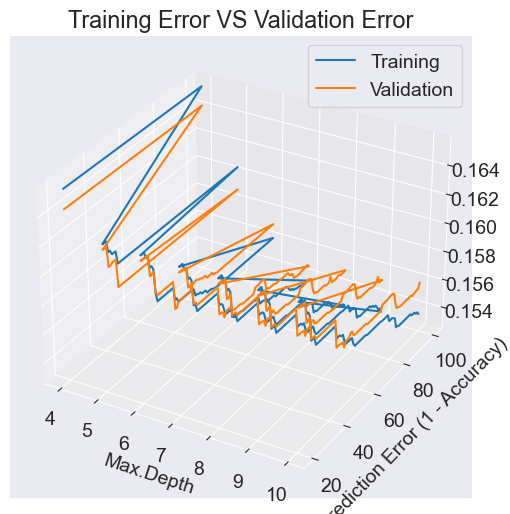

In [74]:
fig = plt.figure()
ax = plt.axes(projection = '3d')

#data for 3d plotting 
ax.plot3D(max_depth_leaf_node_err_df['Max Depth'], max_depth_leaf_node_err_df['Max Leaf Node'], max_depth_leaf_node_err_df['Training Error'])
ax.plot3D(max_depth_leaf_node_err_df['Max Depth'], max_depth_leaf_node_err_df['Max Leaf Node'], max_depth_leaf_node_err_df['Validation Error'])
plt.title('Training Error VS Validation Error')
plt.xlabel('Max.Depth')
plt.ylabel('Prediction Error (1 - Accuracy)')
plt.legend(['Training', 'Validation'])

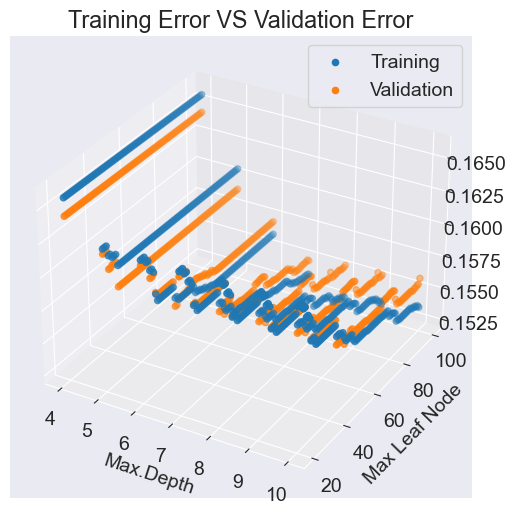

In [75]:
ax2 = plt.axes(projection = '3d')

ax2.scatter(max_depth_leaf_node_err_df['Max Depth'], max_depth_leaf_node_err_df['Max Leaf Node'], max_depth_leaf_node_err_df['Training Error'])
ax2.scatter(max_depth_leaf_node_err_df['Max Depth'], max_depth_leaf_node_err_df['Max Leaf Node'], max_depth_leaf_node_err_df['Validation Error'])
plt.title('Training Error VS Validation Error')
plt.xlabel('Max.Depth')
plt.ylabel('Max Leaf Node')

plt.legend(['Training', 'Validation'])
plt.show()

In [76]:
def model_fit_score(md, mln): 
    model = DecisionTreeClassifier(max_depth = md, max_leaf_nodes = mln, random_state = 42)
    model.fit(X_train, train_target)
    train_acc = model.score(X_train, train_target)
    val_acc = model.score(X_val, val_target)
    return {'Max Depth': md, 'Max Leaf Node': mln, 'Training Accuracy': train_acc, 'Validation Accuracy': val_acc}

In [77]:
print(model_fit_score(7, 94))

{'Max Depth': 7, 'Max Leaf Node': 94, 'Training Accuracy': 0.8458904109589042, 'Validation Accuracy': 0.8449886831872787}


**CHECK CODE ON KAGGLE TO SEE IF THERE'S ANYONE FINDING COMBINATION OF MAX_DEPTH AND MAX_LEAF_NODES THAT GIVE THE HIGHEST VALIDATION ACCURACY
    CHECK CODE TO SEE HOW TO FIND THE LEAF NODES USED** 

# Random Forests
While tuning the hyperparameters of a single decision tree may lead to some improvements, a much more effective strategy is to combine the results of several decision trees trained with slightly different parameters. This is called a random forest model. 

The key idea here is that each decision tree in the forest will make different kinds of errors, and upon averaging, many of their errors will cancel out. This idea is also commonly known as the "wisdom of the crowd":

<img src="https://i.imgur.com/4Dg0XK4.png" width="480">

We'll use the `RandomForestClassifier` class from `sklearn.ensemble`.

In [78]:
from sklearn.ensemble import RandomForestClassifier

ensemble = combining mutiple ML models to make a decision ( the models need not be of the same kind) 


In [79]:
model = RandomForestClassifier(n_jobs=-1, random_state=42)

`n_job=-1`: to train the decision trees in parallel. *Different workers or different CPU threads are used to train the trees in parallel. 
`random_state=42` ensures that we get the fixed set of randomization for each execution. 

In [80]:
%%time
model.fit(X_train, train_target)

CPU times: total: 31.6 s
Wall time: 4.46 s


RandomForestClassifier(n_jobs=-1, random_state=42)

In [81]:
model.score(X_train, train_target)

0.9999494888269285

In [82]:
model.score(X_val, val_target)

0.8568278103418258

Once again, the training accuracy is almost 100%, but this time the validation accuracy is much better. In fact, it is better than the best single decision tree we had trained so far. Do you see the power of random forests?

This general technique of combining the results of many models is called "ensembling", it works because most errors of individual models cancel out on averaging. Here's what it looks like visually:

<img src="https://i.imgur.com/qJo8D8b.png" width="640">


We can also look at the probabilities for the predictions. The probability of a class is simply the fraction of trees which that predicted the given class.

In [83]:
train_probs = model.predict_proba(X_train)
train_probs
#The resulting array: The probability value in the classes in the array corresponds to the fraction of decision trees that predicts that particular class. 

array([[0.93, 0.07],
       [1.  , 0.  ],
       [0.99, 0.01],
       ...,
       [0.99, 0.01],
       [1.  , 0.  ],
       [0.96, 0.04]])

In [84]:
# Using model.estimators_[i] to access the (i+1)-th individual decision trees
model.estimators_[0]

DecisionTreeClassifier(max_features='sqrt', random_state=1608637542)

[Text(0.5, 0.875, 'Sunshine <= 5.85\ngini = 0.347\nsamples = 62607\nvalue = [76887, 22101]\nclass = No'),
 Text(0.25, 0.625, 'Pressure9am <= 1017.35\ngini = 0.499\nsamples = 11288\nvalue = [9272, 8542]\nclass = No'),
 Text(0.125, 0.375, 'Cloud9am <= 7.5\ngini = 0.475\nsamples = 6067\nvalue = [3702, 5808]\nclass = Yes'),
 Text(0.0625, 0.125, '\n  (...)  \n'),
 Text(0.1875, 0.125, '\n  (...)  \n'),
 Text(0.375, 0.375, 'WindGustDir_NNE <= 0.5\ngini = 0.442\nsamples = 5221\nvalue = [5570, 2734]\nclass = No'),
 Text(0.3125, 0.125, '\n  (...)  \n'),
 Text(0.4375, 0.125, '\n  (...)  \n'),
 Text(0.75, 0.625, 'RainToday_Yes <= 0.5\ngini = 0.278\nsamples = 51319\nvalue = [67615, 13559]\nclass = No'),
 Text(0.625, 0.375, 'Pressure9am <= 1012.05\ngini = 0.207\nsamples = 41960\nvalue = [58514, 7796]\nclass = No'),
 Text(0.5625, 0.125, '\n  (...)  \n'),
 Text(0.6875, 0.125, '\n  (...)  \n'),
 Text(0.875, 0.375, 'Pressure9am <= 1017.677\ngini = 0.475\nsamples = 9359\nvalue = [9101, 5763]\nclass = No'

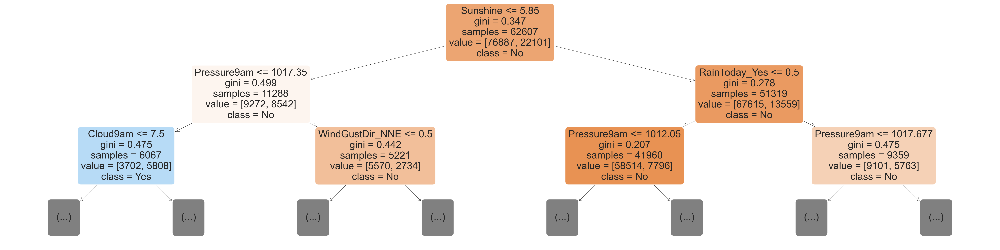

In [85]:
#plot the i-th decision tree
plt.figure(figsize = (80,20))
plot_tree(model.estimators_[0], max_depth=2, feature_names=X_train.columns, filled=True, rounded=True, class_names=model.classes_)

[Text(0.5, 0.875, 'RainToday_Yes <= 0.5\ngini = 0.349\nsamples = 62610\nvalue = [76714, 22274]\nclass = No'),
 Text(0.25, 0.625, 'WindGustDir_ESE <= 0.5\ngini = 0.262\nsamples = 48715\nvalue = [65024, 11930]\nclass = No'),
 Text(0.125, 0.375, 'Pressure3pm <= 1008.65\ngini = 0.267\nsamples = 46043\nvalue = [61211, 11515]\nclass = No'),
 Text(0.0625, 0.125, '\n  (...)  \n'),
 Text(0.1875, 0.125, '\n  (...)  \n'),
 Text(0.375, 0.375, 'Humidity3pm <= 66.5\ngini = 0.177\nsamples = 2672\nvalue = [3813, 415]\nclass = No'),
 Text(0.3125, 0.125, '\n  (...)  \n'),
 Text(0.4375, 0.125, '\n  (...)  \n'),
 Text(0.75, 0.625, 'WindSpeed3pm <= 29.0\ngini = 0.498\nsamples = 13895\nvalue = [11690, 10344]\nclass = No'),
 Text(0.625, 0.375, 'Sunshine <= 7.75\ngini = 0.495\nsamples = 11567\nvalue = [10070, 8283]\nclass = No'),
 Text(0.5625, 0.125, '\n  (...)  \n'),
 Text(0.6875, 0.125, '\n  (...)  \n'),
 Text(0.875, 0.375, 'Sunshine <= 6.15\ngini = 0.493\nsamples = 2328\nvalue = [1620, 2061]\nclass = Yes')

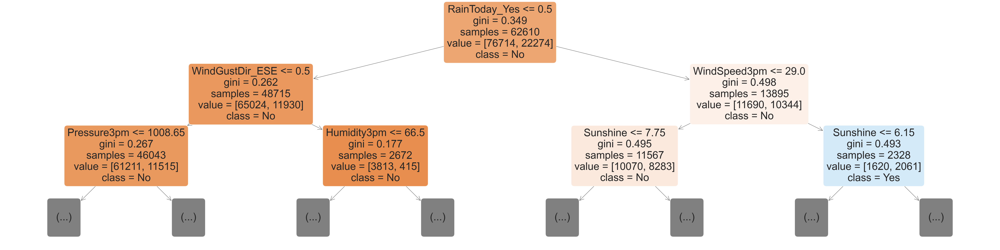

In [86]:
plt.figure(figsize=(80,20))
plot_tree(model.estimators_[20], max_depth=2, feature_names=X_train.columns, filled=True, rounded=True, class_names=model.classes_)

In [87]:
#number of decision trees inside a random forest
len(model.estimators_)

100

In [88]:
#To check the accuracy on validation sets by individual decision trees
def tree_valid_acc (num_tree): 
    model.estimators_[num_tree].fit(X_train, train_target)
    return {'Validation Accuracy': model.estimators_[num_tree]. score(X_val, val_target)}

tree_valid_acc_df = pd.DataFrame([tree_valid_acc(i) for i in range (0, len(model.estimators_))])


Like decision tree, random forests too assign an "importance" to each feature, by combining the importance values from individual decision trees. 

In [89]:
importance_df = pd.DataFrame({'feature': X_train.columns, 
                              'importance': model.feature_importances_}).sort_values('importance', ascending=False)

In [90]:
importance_df.head(10)

,feature,importance
9,Humidity3pm,0.137619
4,Sunshine,0.054143
11,Pressure3pm,0.052535
8,Humidity9am,0.051292
5,WindGustSpeed,0.048973
10,Pressure9am,0.048205
2,Rainfall,0.047038
15,Temp3pm,0.045355
1,MaxTemp,0.042302
0,MinTemp,0.041334


<Axes: title={'center': 'Feature Importance (vertical)'}, xlabel='importance', ylabel='feature'>

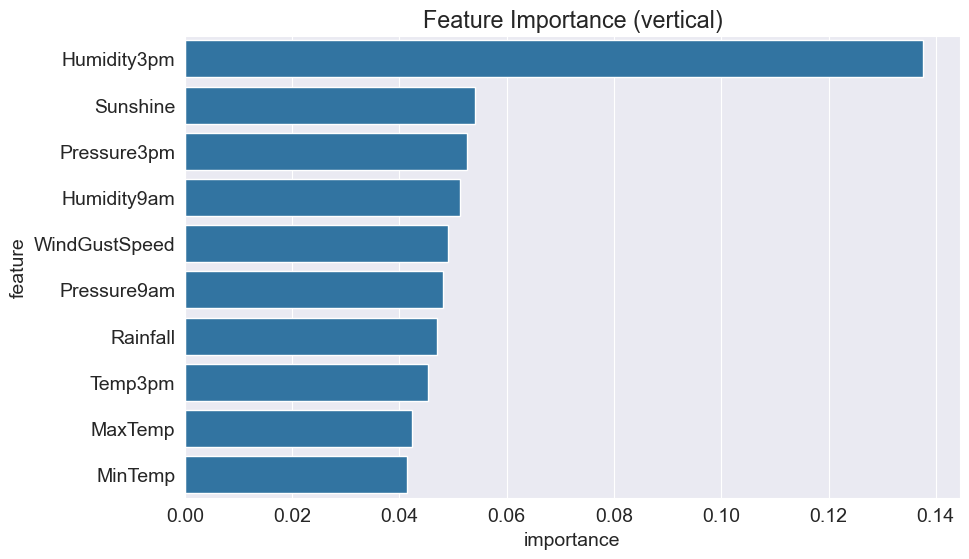

In [91]:
plt.title("Feature Importance (vertical)")
sns.barplot(data=importance_df.head(10), x='feature', y='importance')

<Axes: title={'center': 'Feature Importance (horizontal)'}, xlabel='importance', ylabel='feature'>

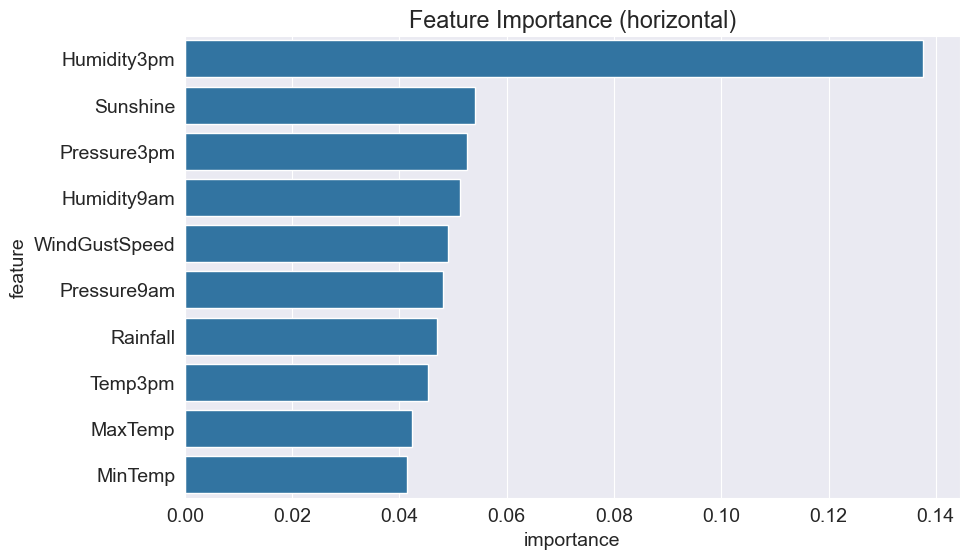

In [92]:
plt.title("Feature Importance (horizontal)")
sns.barplot(data=importance_df.head(10), x='importance', y='feature')

Notice that the distribution is a lot less skewed than that for a single decision tree. 

Now, we would create a base model and use it as a benchmark for hyperparameter tuning. 

In [93]:
#create a model as a baseline when tuning hyperparameters
base_model = RandomForestClassifier(random_state=42, n_jobs=-1).fit(X_train, train_target)

In [94]:
base_train_acc = base_model.score(X_train, train_target)
base_val_acc = base_model.score(X_val, val_target)

In [95]:
base_accs = base_train_acc, base_val_acc

## `n_estimators`

This argument controls the number of decision trees in the random forest. The default value is 100. For larger datasets, it helps to have a greater number of estimators. As a general rule, try to have as few estimators as needed. 

In [96]:
#10 estimators 
model = RandomForestClassifier(random_state=42, n_jobs=-1, n_estimators=10)

In [97]:
model.fit(X_train, train_target)

RandomForestClassifier(n_estimators=10, n_jobs=-1, random_state=42)

In [98]:
model.score(X_train, train_target), model.score(X_val, val_target)

(0.9869479128783287, 0.8488189890313969)

In [99]:
base_accs

(0.9999494888269285, 0.8568278103418258)

In [100]:
#500 estimators
model = RandomForestClassifier(random_state=42, n_jobs=-1, n_estimators=500)
model.fit(X_train, train_target)

RandomForestClassifier(n_estimators=500, n_jobs=-1, random_state=42)

In [101]:
model.score(X_train, train_target), model.score(X_val, val_target)

(0.9999797955307714, 0.8576983343973071)

In [102]:
def num_estimators(ne): 
    model = RandomForestClassifier(random_state=42, n_jobs=-1, n_estimators=ne)
    model.fit(X_train, train_target)
    train_acc, val_acc = model.score(X_train, train_target), model.score(X_val, val_target)
    return {'Num_Estimators': ne, 'Training Accuracy': train_acc, 'Validation Accuracy': val_acc}

%%time 
num_estimators_df = pd.DataFrame([num_estimators(ne) for ne in range (1, 800)]).sort_values('Validation Accuracy', ascending=False)

plt.figure()
plt.plot(num_estimators_df['Num_Estimators'], num_estimators_df['Validation Accuracy'])
plt.title('Num of Estimators VS Validation Accuracy')
pl.xticks(range(0, 801, 20)
plt.xlabel('Num of Estimators')
plt.ylabel('Validation Accuracy')

### `max_depth` and `max_leaf_nodes`

These arguments are passed directly to each decision tree, and control the maximum depth and max. no leaf nodes of each tree respectively. By default, no maximum depth is specified, which is why each tree has a training accuracy of 100%. You can specify a `max_depth` to reduce overfitting.

<img src="https://i.imgur.com/EJCrSZw.png" width="480">


In [104]:
#helper function test_params to tune hyperparameters
def test_params(**params): 
    model = RandomForestClassifier(random_state=42, n_jobs=-1, **params).fit(X_train, train_target)
    print("This model:", model.score(X_train, train_target), model.score(X_val, val_target))
    print("Base model:", base_accs)

In [105]:
test_params(max_depth = 26)

This model: 0.9814522972481513 0.8571179850269862
Base model: (0.9999494888269285, 0.8568278103418258)


In [106]:
test_params(max_leaf_nodes = 2**5)

This model: 0.8314341132258456 0.833904010214149
Base model: (0.9999494888269285, 0.8568278103418258)


In [107]:
test_params(max_depth=26, max_leaf_nodes = 2**5)

This model: 0.8314341132258456 0.833904010214149
Base model: (0.9999494888269285, 0.8568278103418258)


In [108]:
# to test the optimal values of `max_depth` and `max_leaf_nodes` between 0 and unbounded 
def max_depth_leaf_nodes(md, mln): 
    model = RandomForestClassifier(max_depth = md, max_leaf_nodes = mln, random_state = 42)
    model.fit(X_train, train_target)
    train_acc, val_acc = model.score(X_train, train_target), model.score(X_val, val_target)
    return {'Max Depth': md, 'Max Leaf Node': mln, 'Training Accuracy': train_acc, 'Validation Accuracy': val_acc}

%%time
max_depth_leaf_node_err_df = pd.DataFrame([max_depth_leaf_node_err(md, mln) for md in range(4, 11) for mln in range(20, 101)]).sort_values("Validation Accuracy", ascending = False)
#the minimum number of max_leaf_nodes = 2!!

In [110]:
base_accs

(0.9999494888269285, 0.8568278103418258)

### `max_features`

Instead of picking all features (columns) for every split, we can specify that only a fraction of features be chosen randomly to figure out a split.

<img src="https://i.imgur.com/FXGWMDY.png" width="720">

Notice that the default value `auto` causes only $\sqrt{n}$ out of total features ( $n$ ) to be chosen randomly at each split. This is the reason each decision tree in the forest is different. While it may seem counterintuitive, choosing all features for every split of every tree will lead to identical trees, so the random forest will not generalize well. 

In [111]:
test_params(max_features = 'log2')

This model: 0.9999595910615429 0.8554349718530555
Base model: (0.9999494888269285, 0.8568278103418258)


In [112]:
test_params(max_features = 3)

This model: 0.9999595910615429 0.8546224827346063
Base model: (0.9999494888269285, 0.8568278103418258)


In [113]:
test_params(max_features = 6)

This model: 0.9999595910615429 0.8554349718530555
Base model: (0.9999494888269285, 0.8568278103418258)


In [114]:
base_accs

(0.9999494888269285, 0.8568278103418258)

# to test the optimal values of `max_features` 
def max_features(mf): 
    model = RandomForestClassifier((optimum), mf, random_state = 42)
    model.fit(X_train, train_target)
    train_acc, val_acc = model.score(X_train, train_target), model.score(X_val, val_target)
    return {'Max_features': mf,'Training Accuracy': train_acc, 'Validation Accuracy': val_acc}

%%time
max_features_df = pd.DataFrame([max_features(mf) for mf in range(1, 22)]).sort_values("Validation Accuracy", ascending = False)

In [115]:
base_accs

(0.9999494888269285, 0.8568278103418258)

### `min_samples_split` and `min_samples_leaf`

By default, the decision tree classifier tries to split every node that has 2 or more. You can increase the values of these arguments to change this behavior and reduce overfitting, especially for very large datasets.

# to test the optimal values of `min_samples_split` and `min_samples_leaf` between 0 and unbounded 
def minss_minsl(mss, msl): 
    model = RandomForestClassifier((optimum), mss, msl, random_state = 42)
    model.fit(X_train, train_target)
    train_acc, val_acc = model.score(X_train, train_target), model.score(X_val, val_target)
    return {'Min_Sample_Split': mss, 'Min_Sample_Leaf': msl, 'Training Accuracy': train_acc, 'Validation Accuracy': val_acc}

%%time
minss_minsl_df = pd.DataFrame([minss_minsl(mss, msl) for mss in range(3, 201) for msl in range(2, 101)]).sort_values("Validation Accuracy", ascending = False)

In [116]:
base_accs

(0.9999494888269285, 0.8568278103418258)

### `min_impurity_decrease`

This argument is used to control the threshold for splitting nodes. A node will be split if this split induces a decrease of the impurity (Gini index) greater than or equal to this value. It's default value is 0, and you can increase it to reduce overfitting.



# to test the optimal values of `min_impurity_decrease`
# min_purity_decrease: try values between 0 and 0.1  
def min_impurity_decrease(mid): 
    model = RandomForestClassifier((optimum), mid, random_state = 42)
    model.fit(X_train, train_target)
    train_acc, val_acc = model.score(X_train, train_target), model.score(X_val, val_target)
    return {'Min_Impurity_Decrease': mid, 'Training Accuracy': train_acc, 'Validation Accuracy': val_acc}

%%time
mid_df = pd.DataFrame([min_impurity_decrease(mid) for mid in np.arange(0.01, 0.11, 0.01)]).sort_values("Validation Accuracy", ascending = False)

In [117]:
base_accs

(0.9999494888269285, 0.8568278103418258)

### `bootstrap`, `max_samples` 

By default, a random forest doesn't use the entire dataset for training each decision tree. Instead it applies a technique called bootstrapping. For each tree, rows from the dataset are picked one by one randomly, with replacement i.e. some rows may not show up at all, while some rows may show up multiple times.


<img src="https://i.imgur.com/W8UGaEA.png" width="640">

Bootstrapping helps the random forest generalize better, because each decision tree only sees a fraction of th training set, and some rows randomly get higher weightage than others.

# to test the optimal values of `max_samples`
def max_samples(maxs): 
    model = RandomForestClassifier((optimum), maxs, random_state = 42)
    model.fit(X_train, train_target)
    train_acc, val_acc = model.score(X_train, train_target), model.score(X_val, val_target)
    return {'Max_Samples': maxs, 'Training Accuracy': train_acc, 'Validation Accuracy': val_acc}

%%time
max_samples_df = pd.DataFrame([max_samples(maxs) for maxs in np.arange(0.1, 1.1, 0.1)]).sort_values("Validation Accuracy", ascending = False)

In [119]:
base_accs

(0.9999494888269285, 0.8568278103418258)

## `class_weights`- 
Say "yes/no", if yeses are relatively low, we can give higher weightage to the rows whose target value is yes so that they are considered few times important in the calculation
- 
These weightages would be used in Gini calculation and in splitti
- ` 
class_weight = 'balanc`ed': the program automatically detects the multiple (might not necessarily be the best choie)


In [120]:
model.classes_

array(['No', 'Yes'], dtype=object)

In [121]:
test_params(class_weight={'No': 1, 'Yes': 2})

This model: 0.9999595910615429 0.8561313910974406
Base model: (0.9999494888269285, 0.8568278103418258)


In [122]:
test_params(class_weight={'No': 1, 'Yes': 1.5})

This model: 0.9999494888269285 0.8556671116011839
Base model: (0.9999494888269285, 0.8568278103418258)


In [123]:
test_params(class_weight={'No': 1, 'Yes': 3})

This model: 0.9999595910615429 0.8530555394347397
Base model: (0.9999494888269285, 0.8568278103418258)


In [124]:
test_params(class_weight={'No': 1, 'Yes': 1.75})

This model: 0.9999595910615429 0.8572920898380825
Base model: (0.9999494888269285, 0.8568278103418258)


In [125]:
test_params(class_weight={'No': 1, 'Yes': 1.9})

This model: 0.9999595910615429 0.8553189019789914
Base model: (0.9999494888269285, 0.8568278103418258)


In [126]:
test_params(class_weight='balanced')

This model: 0.9999595910615429 0.8554349718530555
Base model: (0.9999494888269285, 0.8568278103418258)


In [127]:
base_accs

(0.9999494888269285, 0.8568278103418258)

## Putting it together 
putting all optimal hyperparameters tgt:

Depending on the dataset and the kind of problem, you may or may not a see a significant improvement with hyperparameter tuning. 

This could be due to any of the following reasons:

- We may not have found the right mix of hyperparameters to regularize (reduce overfitting) the model properly, and we should keep trying to improve the model.

- We may have reached the limits of the modeling technique we're currently using (Random Forests), and we should try another modeling technique e.g. gradient boosting.

- We may have reached the limits of what we can predict using the given amount of data, and we may need more data to improve the model.

- We may have reached the limits of how well we can predict whether it will rain tomorrow using the given weather measurements, and we may need more features (columns) to further improve the model. In many cases, we can also generate new features using existing features (this is called feature engineering).

- Whether it will rain tomorrow may be an inherently random or chaotic phenomenon which simply cannot be predicted beyond a certain accuracy any amount of data for any number of weather measurements with any modeling technique.  

Remember that ultimately all models are wrong, but some are useful. If you can rely on the model we've created today to make a travel decision for tomorrow, then the model is useful, even though it may sometimes be wrong.

In [128]:
base_accs

(0.9999494888269285, 0.8568278103418258)

In [ ]:
model = RandomForestClassifier(n_jobs=-1, 
                               random_state=42, 
                               n_estimators=500,
                               max_features=7,
                               max_depth=30, 
                               class_weight={'No': 1, 'Yes': 1.5})
model.fit(X_train, train_target)
model.score(X_train, train_target), model.score(X_val, val_target)

### Strategy for Tuning Hyperparameters

Here's a good strategy for tuning hyperparameters:

1. Tune the most important/impactful hyperparameter first e.g. n_estimators

2. With the best value of the first hyperparameter, tune the next most impactful hyperparameter

3. And so on, keep training the next most impactful parameters with the best values for previous parameters...

4. Then, go back to the top and further tune each parameter again for further marginal gains

Keep your ideas and experiments organized using an experiment tracking sheet: https://bit.ly/mltrackingsheet


Your first objective should be make the training loss as low as possible (even if the validation loss is very large), and then try to regularize the model to slowly decrease the valiadation loss while increasing the training loss.


Hyperparameter tuning is more art than science, unfortunately. Try to get a feel for how the parameters interact with each other based on your understanding of the parameter

Finally, let's also compute the accuracy of our model on the test set.

In [ ]:
model.score(X_test, test_target)

## Making Predictions on New Inputs

Let's define a helper function to make predictions on new inputs.

In [ ]:
def predict_input(model, single_input):
    input_df = pd.DataFrame([single_input])
    input_df[numeric_cols] = imputer.transform(input_df[numeric_cols])
    input_df[numeric_cols] = scaler.transform(input_df[numeric_cols])
    input_df[encoded_cols] = encoder.transform(input_df[categorical_cols])
    X_input = input_df[numeric_cols + encoded_cols]
    pred = model.predict(X_input)[0]
    prob = model.predict_proba(X_input)[0][list(model.classes_).index(pred)]
    return pred, prob

In [ ]:
new_input = {'Date': '2021-06-19',
             'Location': 'Launceston',
             'MinTemp': 23.2,
             'MaxTemp': 33.2,
             'Rainfall': 10.2,
             'Evaporation': 4.2,
             'Sunshine': np.nan,
             'WindGustDir': 'NNW',
             'WindGustSpeed': 52.0,
             'WindDir9am': 'NW',
             'WindDir3pm': 'NNE',
             'WindSpeed9am': 13.0,
             'WindSpeed3pm': 20.0,
             'Humidity9am': 89.0,
             'Humidity3pm': 58.0,
             'Pressure9am': 1004.8,
             'Pressure3pm': 1001.5,
             'Cloud9am': 8.0,
             'Cloud3pm': 5.0,
             'Temp9am': 25.7,
             'Temp3pm': 33.0,
             'RainToday': 'Yes'}

## Saving and Loading Trained Models

We can save the parameters (weights and biases) of our trained model to disk, so that we needn't retrain the model from scratch each time we wish to use it. Along with the model, it's also important to save imputers, scalers, encoders and even column names. Anything that will be required while generating predictions using the model should be saved.

We can use the `joblib` module to save and load Python objects on the disk. 

In [ ]:
import joblib

In [ ]:
aussie_rain = {
    'model': model,
    'imputer': imputer,
    'scaler': scaler,
    'encoder': encoder,
    'input_cols': input_cols,
    'target_col': target_col,
    'numeric_cols': numeric_cols,
    'categorical_cols': categorical_cols,
    'encoded_cols': encoded_cols
}

In [ ]:
joblib.dump(aussie_rain, 'aussie_rain.joblib')

In [ ]:
aussie_rain2 = joblib.load('aussie_rain.joblib')

In [ ]:
test_preds2 = aussie_rain2['model'].predict(X_test)
accuracy_score(test_target, test_preds2)

## Summary and References

The following topics were covered in this tutorial:

- Downloading a real-world dataset
- Preparing a dataset for training
- Training and interpreting decision trees
- Training and interpreting random forests
- Overfitting & hyperparameter tuning
- Making predictions on single inputs



We also introduced the following terms:

* Decision tree
* Random forest
* Overfitting
* Hyperparameter
* Hyperparameter tuning
* Ensembling
* Generalization
* Bootstrapping


Check out the following resources to learn more: 

- https://scikit-learn.org/stable/modules/tree.html
- https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestClassifier.html
- https://www.kaggle.com/willkoehrsen/start-here-a-gentle-introduction
- https://www.kaggle.com/willkoehrsen/introduction-to-manual-feature-engineering
- https://www.kaggle.com/willkoehrsen/intro-to-model-tuning-grid-and-random-search
- https://www.kaggle.com/c/home-credit-default-risk/discussion/64821
